In [1]:
# initialize
%matplotlib inline

from nilearn import plotting
from nilearn import image

In [2]:
# specify file path
origin_func_files = 'tasks/flanker_task/data/sub001/run001.nii'

struct_filepath = 'tasks/flanker_task/data/sub001/struct.nii'

c:\users\yunfeiluo\appdata\local\programs\python\python36\lib\site-packages\nilearn\image\resampling.py:513: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))



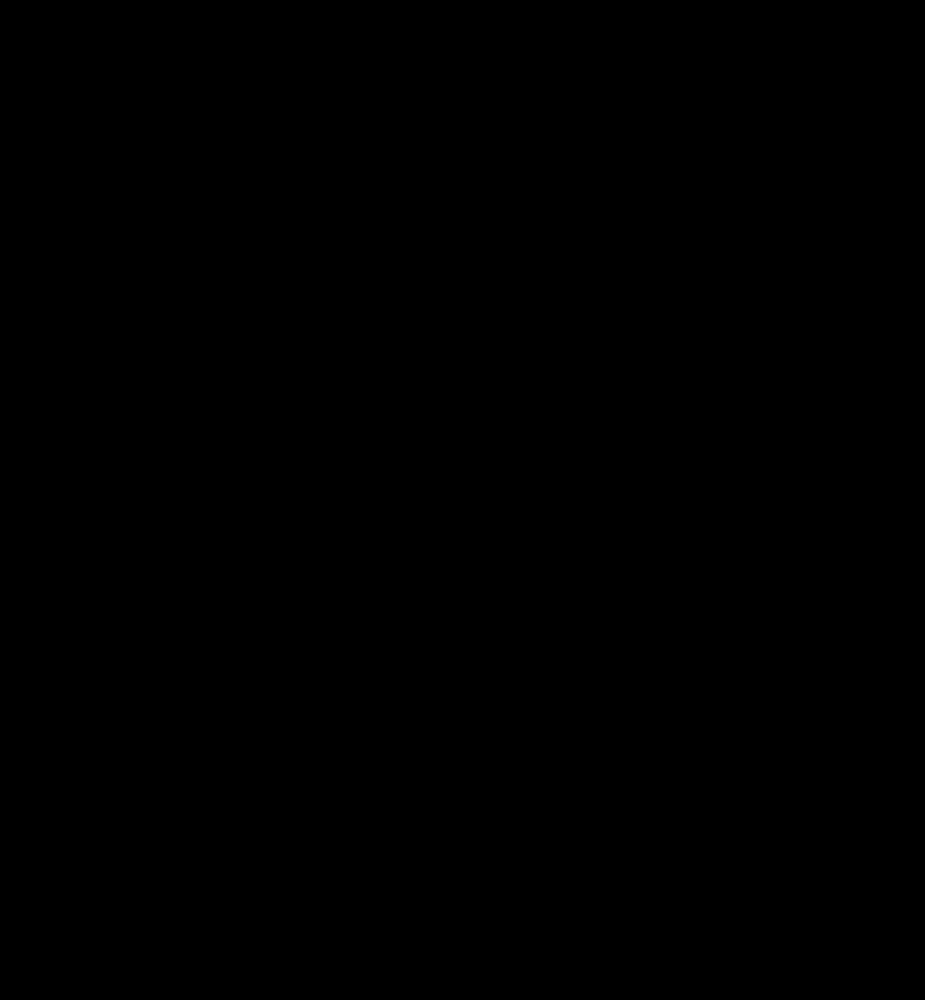
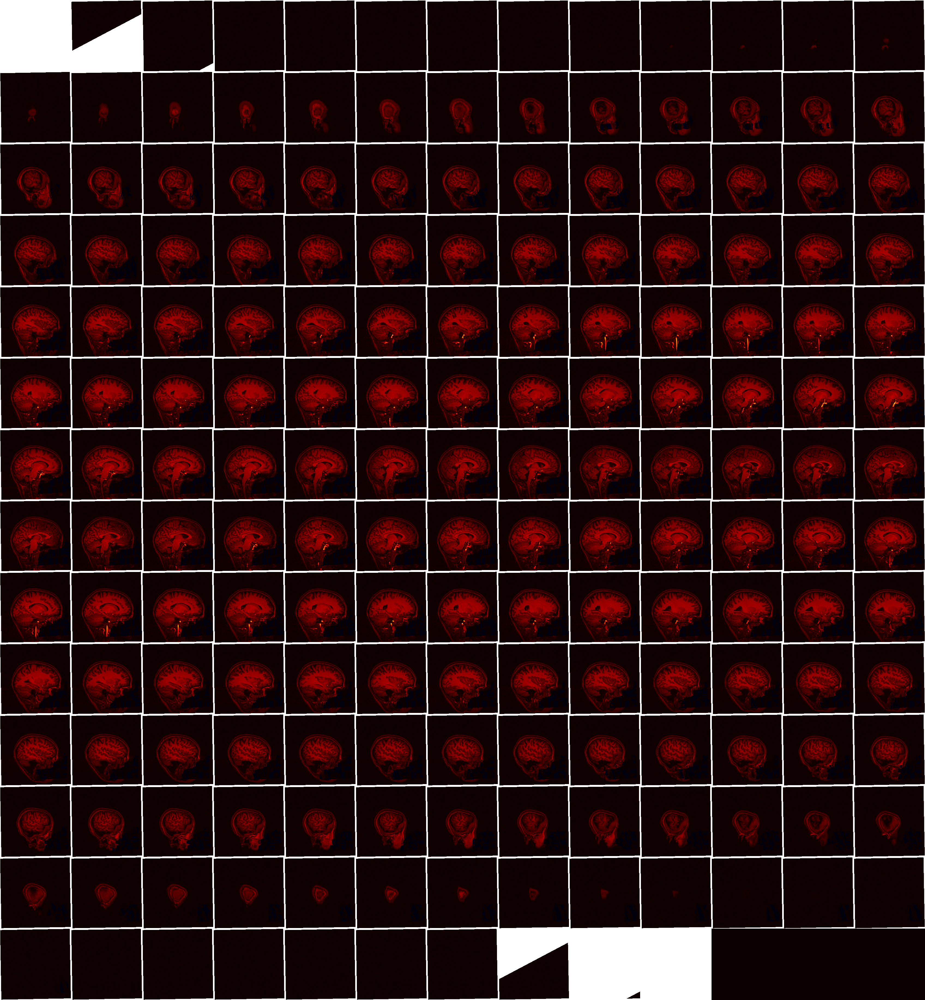

In [3]:
interact_view = plotting.view_img(stat_map_img=struct_filepath, bg_img=None, threshold=None, title='structure view')
interact_view

num of time step 146


c:\users\yunfeiluo\appdata\local\programs\python\python36\lib\site-packages\nilearn\image\resampling.py:513: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))


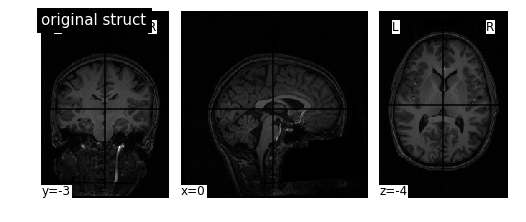

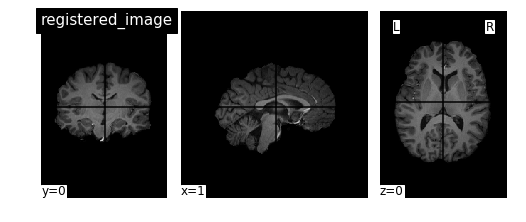

In [5]:
# plot functional MRI
shape = image.load_img(origin_func_files).shape
print('num of time step', shape[-1])

# specify time steps to look at
time_steps = [i for i in range(shape[-1])]

from matplotlib.animation import FuncAnimation

def visualize_func(time_steps, files, title):
    for step in time_steps:
        img = image.index_img(files, step)

        plotting.plot_img(img, title=title, cmap='gray')
        
plotting.plot_img(struct_filepath, cmap='gray', title='original struct')
plotting.plot_img('tasks/flanker_task/output/FuNP/sub001/registered_file/struct_resample_brain.nii', cmap='gray', title='registered_image')
plotting.show()

c:\users\yunfeiluo\appdata\local\programs\python\python36\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


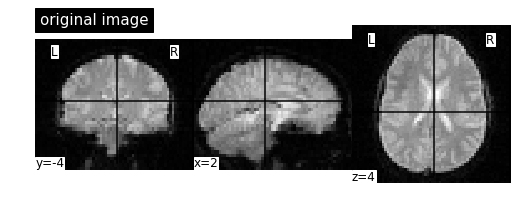

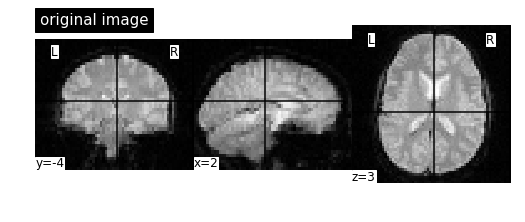

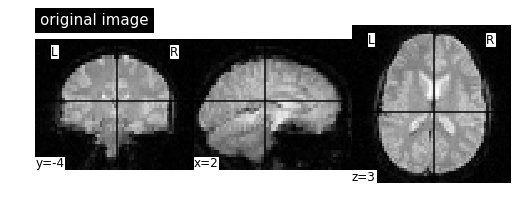

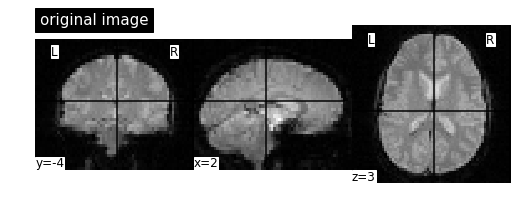

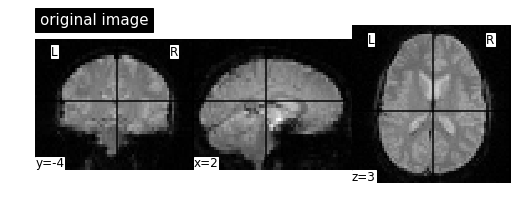

...

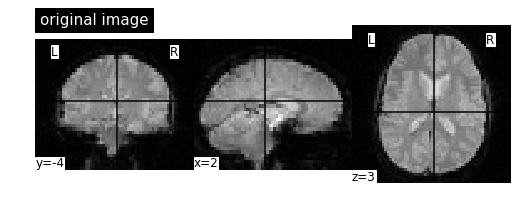

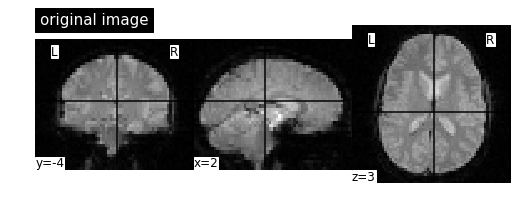

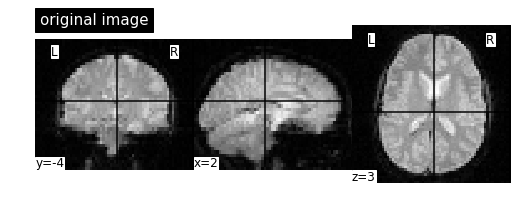

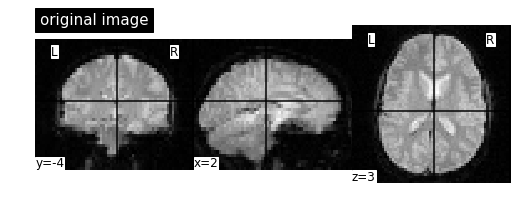

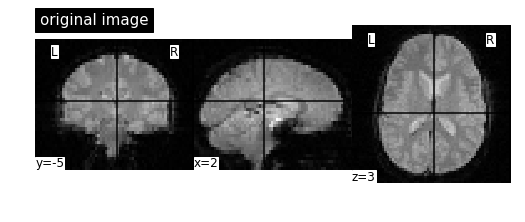

In [6]:
# plot result from FuNP
normalized_files = 'tasks/flanker_task/output/FuNP/sub001/before_smooth/wvol0000_bet_merged.nii'
smoothed_files = 'tasks/flanker_task/output/FuNP/sub001/final_out/swvol0000_bet_merged.nii'

# origin
visualize_func(time_steps, origin_func_files, 'original image')

plotting.show()

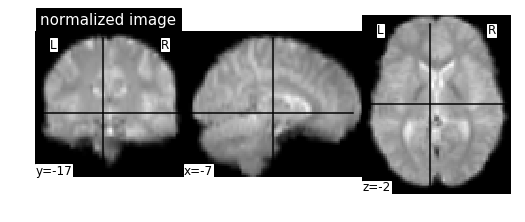

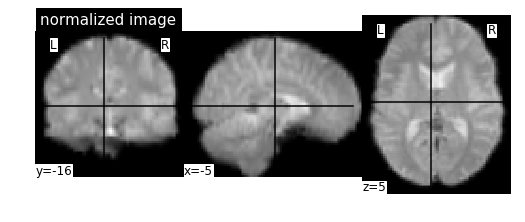

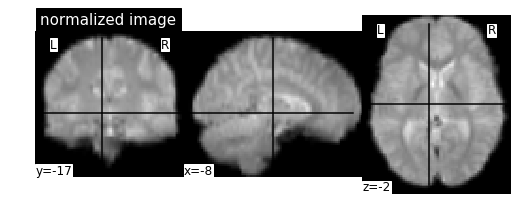

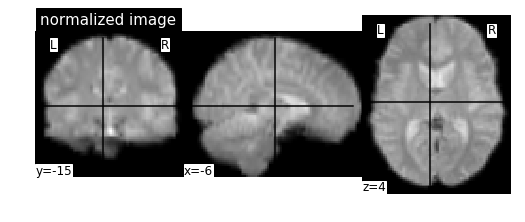

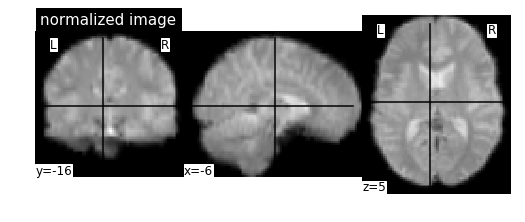

...

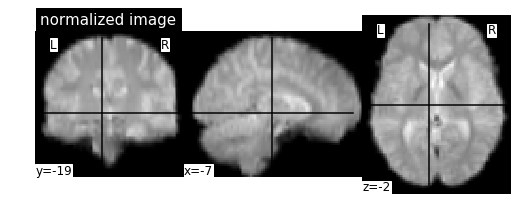

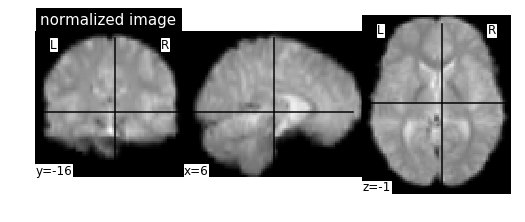

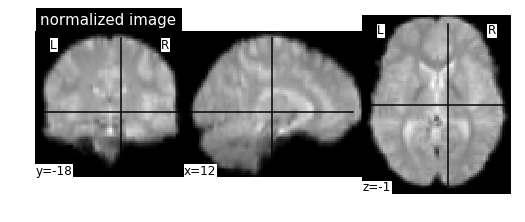

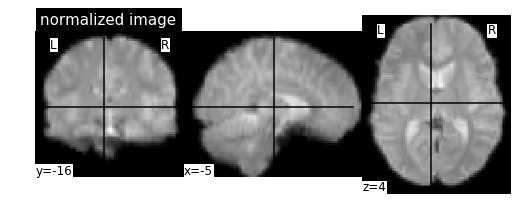

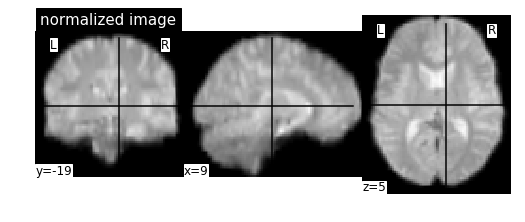

In [8]:
# before smooth
visualize_func(time_steps, normalized_files, 'normalized image')
plotting.show()

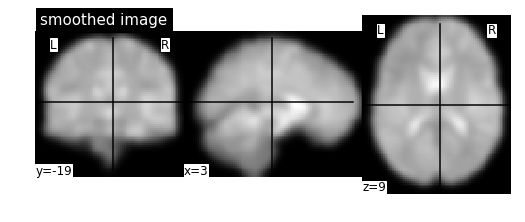

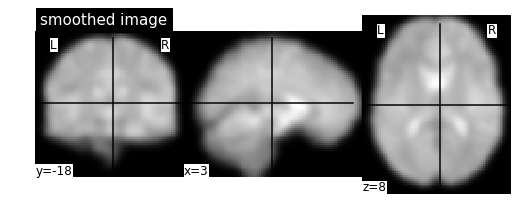

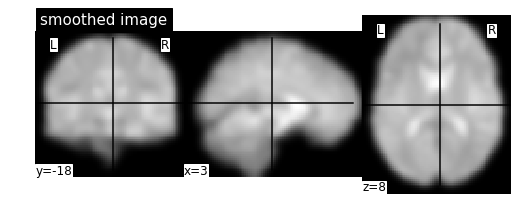

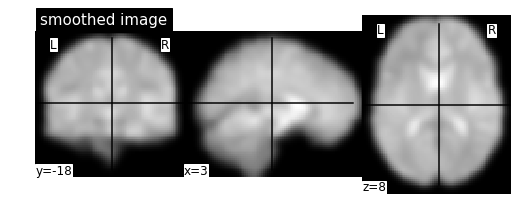

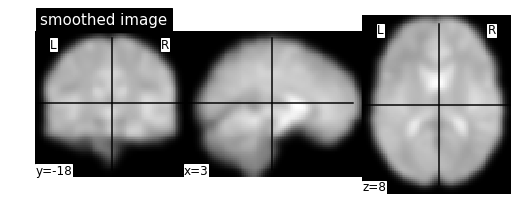

...

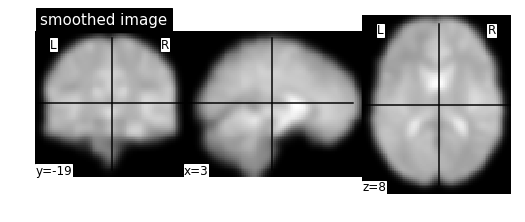

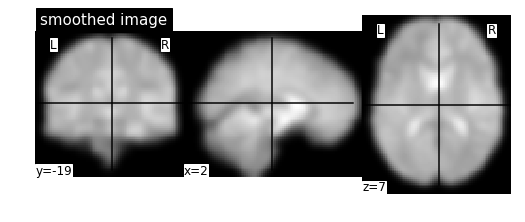

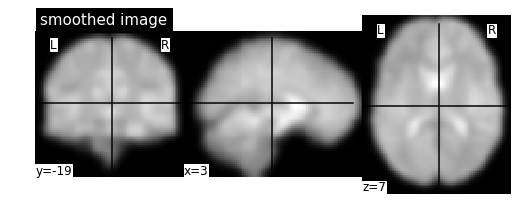

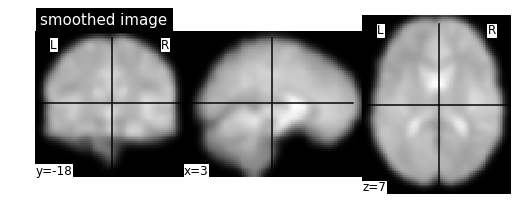

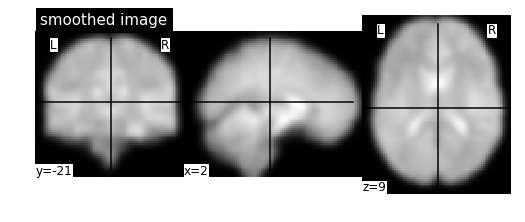

In [9]:
# final output
visualize_func(time_steps, smoothed_files, 'smoothed image')
plotting.show()

In [10]:
# checking
import nibabel as nib

img = nib.load(normalized_files)
img1 = nib.load(smoothed_files)
print('before smooth', img.shape)
print('after smooth', img1.shape)

before smooth (79, 95, 78, 146)
after smooth (79, 95, 78, 146)
